# Feature extraction: naive methods

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import os
import sys
from copy import deepcopy

import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import pandas as pd
pd.options.display.max_columns = 100
import umap
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler


if __package__ is None:

    module_path = os.path.abspath(os.path.join('..'))
    sys.path.append(module_path)

    __package__ = os.path.basename(module_path)


from src.utils.misc.numerical import count_monotonic_group_lengths, find_monotonic_group_idxs, is_within_range
from src.utils.misc.string_handling import string_to_tuple_list
from src.utils.misc.type_handling import flatten_listlike, get_first_elements
from src.utils.results.analytics.naming import get_true_interaction_cols
from src.utils.results.visualisation import hist3d
from tests_local.shared import CONFIG

# config = load_json_as_dict('../tests_local/configs/simple_circuit.json')
SEQ_LENGTH = 20
config = deepcopy(CONFIG)

2023-04-20 09:32:50.298071: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-20 09:32:50.380669: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-04-20 09:32:50.827891: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: :/home/wadh6511/miniconda3/lib/
2023-04-20 09:32:50.827967: W tensorflow/compiler/xla/s

## Process data

In [3]:
fn = '../data/ensemble_mutation_effect_analysis/2023_04_11_192013/summarise_simulation/tabulated_mutation_info.csv'
info = pd.read_csv(fn)

Binding site expansion

In [4]:
num_group_cols = [e.replace('energies', 'binding_sites_groups') for e in get_true_interaction_cols(info, 'energies')]
num_bs_cols = [e.replace('energies', 'binding_sites_count') for e in get_true_interaction_cols(info, 'energies')]
bs_idxs_cols = [e.replace('energies', 'binding_sites_idxs') for e in get_true_interaction_cols(info, 'energies')]
bs_range_cols = [e.replace('energies', 'binding_site_group_range') for e in get_true_interaction_cols(info, 'energies')]

for b, g, bs, bsi, r in zip(get_true_interaction_cols(info, 'binding_sites'), num_group_cols, num_bs_cols, bs_idxs_cols, bs_range_cols):
    fbs = [string_to_tuple_list(bb) for bb in info[b]]
    first = get_first_elements(fbs, empty_replacement=[])
    info[bs] = [count_monotonic_group_lengths(bb) for bb in first]
    info[bsi] = [find_monotonic_group_idxs(bb) for bb in first]
    info[g] = info[bs].apply(len)
    info[r] = [[(bb[0], bb[-1]) for bb in b] for b in info[bsi]]

Sensitivity vs. Precision distance to robust quadrant

In [5]:

# %%
info['sp_distance'] = 0 
info.loc[(info['sensitivity_wrt_species-6'] <= 1) & (info['precision_wrt_species-6'] <= 10), 'sp_distance'] = np.sqrt(
    np.power(1-info['sensitivity_wrt_species-6'], 2) + np.power(10 - info['precision_wrt_species-6'], 2))
info.loc[(info['sensitivity_wrt_species-6'] <= 1) & (info['precision_wrt_species-6'] > 10), 'sp_distance'] = np.absolute(info['sensitivity_wrt_species-6'] - 1)
info.loc[(info['sensitivity_wrt_species-6'] > 1) & (info['precision_wrt_species-6'] <= 10), 'sp_distance'] = np.absolute(info['precision_wrt_species-6'] - 10)


In [6]:
info['num_interacting_all'] = info['num_interacting'] + info['num_self_interacting']

Mutation logs

In [7]:
numerical_cols = [c for c in info.columns if (type(info[(info['mutation_num'] > 0) & (info['eqconstants_0-0'] > 1)][c].iloc[0]) != str) and (type(info[c].iloc[0]) != list) and c not in get_true_interaction_cols(info, 'binding_sites')]
key_cols = ['circuit_name', 'interacting', 'mutation_name', 'name', 'sample_name']

grouped = info.groupby(['circuit_name', 'sample_name'], as_index=False)

mutation_log = grouped[numerical_cols].apply(lambda x: np.log(x / x.loc[x['mutation_num'] == 0].squeeze()))
mutation_log['mutation_num'] = info['mutation_num']
mutation_log['RMSE'] = info['RMSE']
# mutation_log['sp_distance'] = info['sp_distance']
for c in key_cols:
    mutation_log[c] = info[c]

/home/wadh6511/Kode/env_circuits/lib/python3.10/site-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/home/wadh6511/Kode/env_circuits/lib/python3.10/site-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)
/tmp/ipykernel_103193/2198938136.py:6: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  mutation_log = grouped[numerical_cols].apply(lambda x: np.log(x / x.loc[x['mutation_num'] == 0].squeeze()))


In [45]:

# %%
num_group_cols = [e.replace('energies', 'binding_sites_groups') for e in get_true_interaction_cols(info, 'energies')]
num_bs_cols = [e.replace('energies', 'binding_sites_count') for e in get_true_interaction_cols(info, 'energies')]
bs_idxs_cols = [e.replace('energies', 'binding_sites_idxs') for e in get_true_interaction_cols(info, 'energies')]
bs_range_cols = [e.replace('energies', 'binding_site_group_range') for e in get_true_interaction_cols(info, 'energies')]


# %%
for b, g, bs, bsi, r in zip(get_true_interaction_cols(info, 'binding_sites'), num_group_cols, num_bs_cols, bs_idxs_cols, bs_range_cols):
    fbs = [string_to_tuple_list(bb) for bb in info[b]]
    first = get_first_elements(fbs, empty_replacement=[])
    info[bs] = [count_monotonic_group_lengths(bb) for bb in first]
    info[bsi] = [find_monotonic_group_idxs(bb) for bb in first]
    info[g] = info[bs].apply(len)
    info[r] = [[(bb[0], bb[-1]) for bb in b] for b in info[bsi]]

# %%
good_cols = list(info.columns)
[good_cols.remove(x) for x in get_true_interaction_cols(info, 'binding_rates_dissociation') + get_true_interaction_cols(info, 'eqconstants') +
 get_true_interaction_cols(info, 'energies') + get_true_interaction_cols(info, 'binding_sites') + num_group_cols + num_bs_cols]
good_cols


# %%
binding_idx_map = {e.replace('energies_', ''): i for i, e in enumerate(get_true_interaction_cols(info, 'energies'))}

# %%
infom = info.melt(good_cols, value_vars=get_true_interaction_cols(info, 'energies'), var_name='idx', value_name='energies')
dfm = info.melt(good_cols, value_vars=num_group_cols, var_name='num_groups_idx', value_name='num_groups')
infom['idx_species_binding'] = dfm['num_groups_idx'].apply(lambda x: binding_idx_map[x.replace('binding_sites_groups_', '')])
infom['num_groups'] = dfm['num_groups']
dfm = info.melt(good_cols, value_vars=num_bs_cols, var_name='num_bs_idx', value_name='num_bs')
infom['num_bs'] = dfm['num_bs']

for k in ['binding_sites', 'binding_rates_dissociation', 'eqconstants']:
    dfm = info.melt(good_cols, value_vars=get_true_interaction_cols(info, k), var_name=f'{k}_idx', value_name=k)
    infom[k] = dfm[k]


# Energy diffs:

# %%
for k in ['binding_rates_dissociation', 'eqconstants', 'energies']:
    infom[f'{k}_diffs'] = info.groupby(['circuit_name'])[get_true_interaction_cols(info, f'{k}')].apply(lambda x: x - x.iloc[0]).melt(value_vars=get_true_interaction_cols(info, f'{k}'), var_name='idx', value_name=f'{k}_diffs')[f'{k}_diffs']


/tmp/ipykernel_103193/2463550724.py:44: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  infom[f'{k}_diffs'] = info.groupby(['circuit_name'])[get_true_interaction_cols(info, f'{k}')].apply(lambda x: x - x.iloc[0]).melt(value_vars=get_true_interaction_cols(info, f'{k}'), var_name='idx', value_name=f'{k}_diffs')[f'{k}_diffs']
/tmp/ipykernel_103193/2463550724.py:44: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group

## Features

Convert to Z-scores

In [8]:
data = info[(info['sample_name'] == 'RNA_1')].dropna(axis=1)
# data = data[np.abs(data[numerical_cols]) < 1e11]
d = data[['sensitivity_wrt_species-6', 'precision_wrt_species-6']]
scaled_data_sp = StandardScaler().fit_transform(d)

Grouped

In [38]:
info[info['sample_name'] == 'RNA_1'].pivot_table('overshoot', ['sample_name', 'mutation_name'], 'circuit_name')


circuit_name               toy_mRNA_circuit_10000  toy_mRNA_circuit_10043  \
sample_name mutation_name                                                   
RNA_1       RNA_0_m1-0                   0.791203                     0.0   
            RNA_0_m1-1                   0.801289                     0.0   
            RNA_0_m1-2                   0.732269                     0.0   
            RNA_0_m1-3                   0.000000                     0.0   
            RNA_0_m1-4                   0.481735                     0.0   
...                                           ...                     ...   
            RNA_2_m5-4                   0.000000                     0.0   
            RNA_2_m5-5                   0.000000                     0.0   
            RNA_2_m5-6                   0.000000                     0.0   
            RNA_2_m5-7                   0.000000                     0.0   
            ref_circuit                  0.765835                     0.0   

circuit_name               toy_mRNA_circuit_10045  toy_mRNA_circuit_10051  \
sample_name mutation_name                                                   
RNA_1       RNA_0_m1-0                        0.0                0.000000   
            RNA_0_m1-1                        0.0                0.000000   
            RNA_0_m1-2                        0.0                0.000000   
            RNA_0_m1-3                        0.0                0.510513   
            RNA_0_m1-4                        0.0                0.000000   
...                                           ...                     ...   
            RNA_2_m5-4                        0.0                0.000000   
            RNA_2_m5-5                        0.0                0.001286   
            RNA_2_m5-6                        0.0                0.000000   
            RNA_2_m5-7                        0.0                0.010454   
            ref_circuit                       0.0                0.000000   

circuit_name               toy_mRNA_circuit_10053  toy_mRNA_circuit_10063  \
sample_name mutation_name                                                   
RNA_1       RNA_0_m1-0                   0.000000                     0.0   
            RNA_0_m1-1                   0.540344                     0.0   
            RNA_0_m1-2                   1.148201                     0.0   
            RNA_0_m1-3                   0.800461                     0.0   
            RNA_0_m1-4                   1.073837                     0.0   
...                                           ...                     ...   
            RNA_2_m5-4                   0.000000                     0.0   
            RNA_2_m5-5                   0.011782                     0.0   
            RNA_2_m5-6                   0.000000                     0.0   
            RNA_2_m5-7                   0.000000                     0.0   
            ref_circuit                  1.077988                     0.0   

circuit_name               toy_mRNA_circuit_10073  toy_mRNA_circuit_10074  \
sample_name mutation_name                                                   
RNA_1       RNA_0_m1-0                   1.148708                0.372070   
            RNA_0_m1-1                   0.000000                0.006063   
            RNA_0_m1-2                   0.876247                0.500519   
            RNA_0_m1-3                   0.927753                0.982861   
            RNA_0_m1-4                   1.139038                0.982861   
...                                           ...                     ...   
            RNA_2_m5-4                   0.000000                0.484634   
            RNA_2_m5-5                   0.000000                0.000000   
            RNA_2_m5-6                   0.000000                0.000000   
            RNA_2_m5-7                   0.000000                0.000000   
            ref_circuit                  1.264648                0.496

In [40]:
grp_mutations = np.concatenate([
    info[info['sample_name'] == 'RNA_1'].pivot_table('overshoot', ['sample_name', 'mutation_name'], 'circuit_name').to_numpy(),
    info[info['sample_name'] == 'RNA_1'].pivot_table('sensitivity_wrt_species-6', ['sample_name', 'mutation_name'], 'circuit_name').to_numpy(),
    info[info['sample_name'] == 'RNA_1'].pivot_table('precision_wrt_species-6', ['sample_name', 'mutation_name'], 'circuit_name').to_numpy()
]).T

In [41]:
grp_mutations.shape

(1000, 363)

## UMAP

In [11]:
reducer = umap.UMAP()

In [13]:
# reducer = umap.UMAP(random_state=42)
# reducer.fit(scaled_data[:10000, :])

In [14]:
xxx
embedding = reducer.fit_transform(scaled_data_sp[:1000, :])
# embedding = reducer.embedding_
embedding.shape

NameError: name 'xxx' is not defined

In [ ]:
np.save('test', embedding)

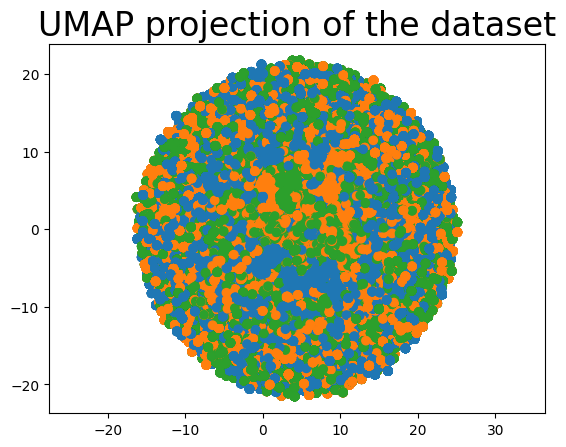

In [ ]:
plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    c=[sns.color_palette()[x] for x in info['sample_name'].map({"RNA_0":0, "RNA_1":1, "RNA_2":2})])
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the dataset', fontsize=24);

In [ ]:
# fig = px.scatter_3d(
#     mutation_log,
#     x=embedding[:, 0], y=embedding[:, 1], z='sp_distance', 
#     color=[sns.color_palette()[x] for x in info['sample_name'].map({"RNA_0":0, "RNA_1":1, "RNA_2":2})])
# fig.show()

fig = hist3d(data=None, x=embedding[:, 0], y=embedding[:, 1])
fig.show()

In [ ]:
digits_df = pd.DataFrame(digits.data[:,1:11])
digits_df['digit'] = pd.Series(digits.target).map(lambda x: 'Digit {}'.format(x))
sns.pairplot(digits_df, hue='digit', palette='Spectral');

## TSNE

### TSNE on precision vs. sensitivity

In [ ]:
tsne = TSNE(n_components=2, random_state=0)
projections = tsne.fit_transform(d)

In [ ]:
data['projection_0'] = projections[:, 0]
data['projection_1'] = projections[:, 1]

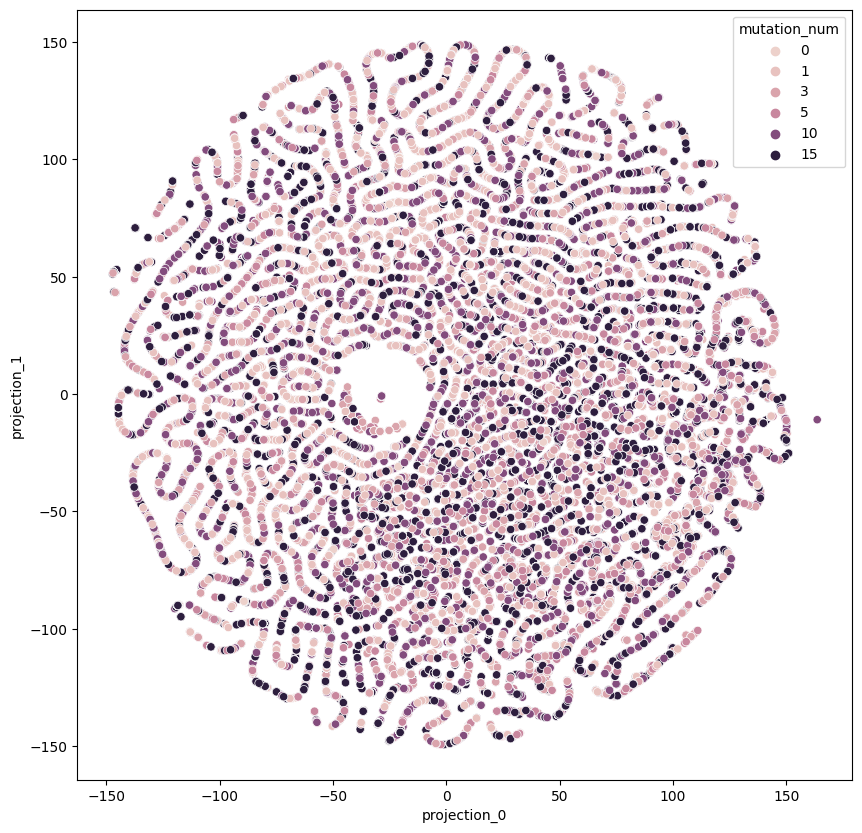

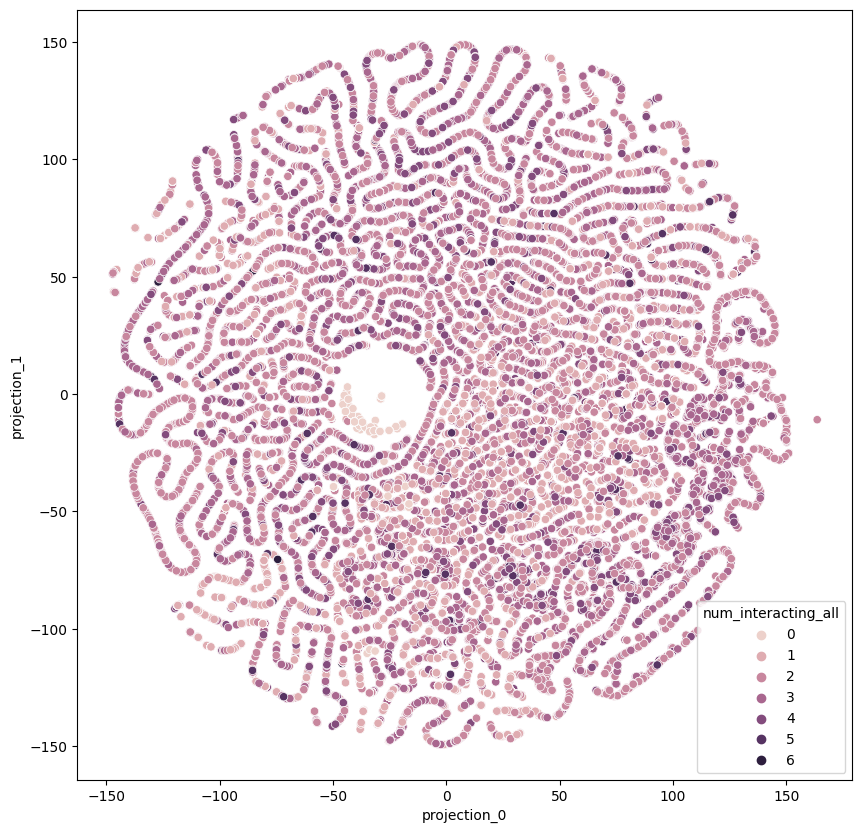

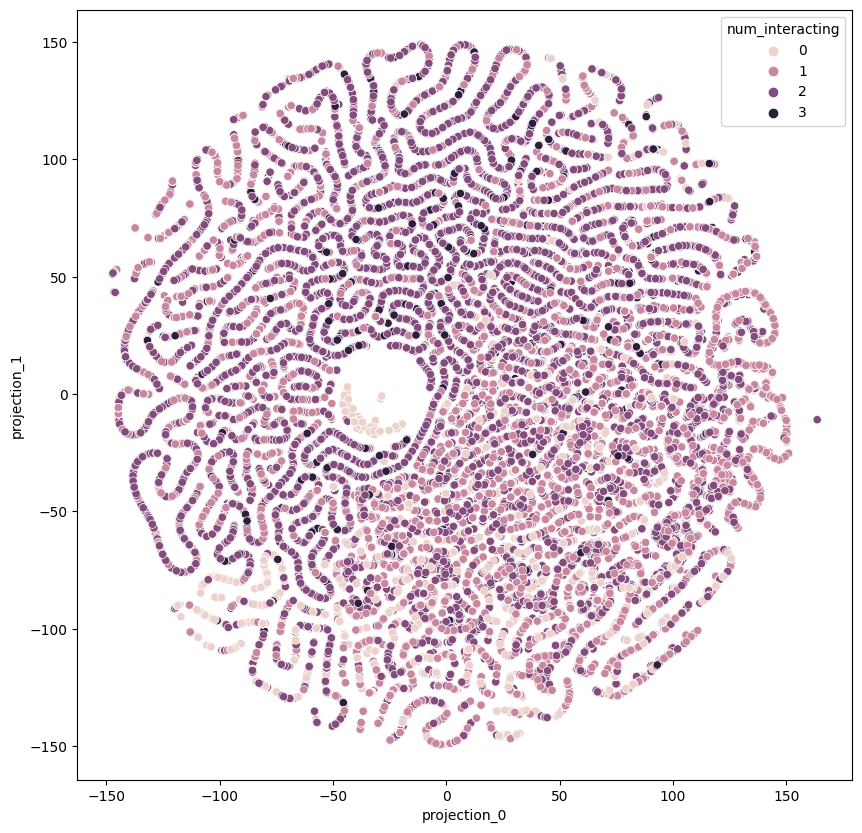

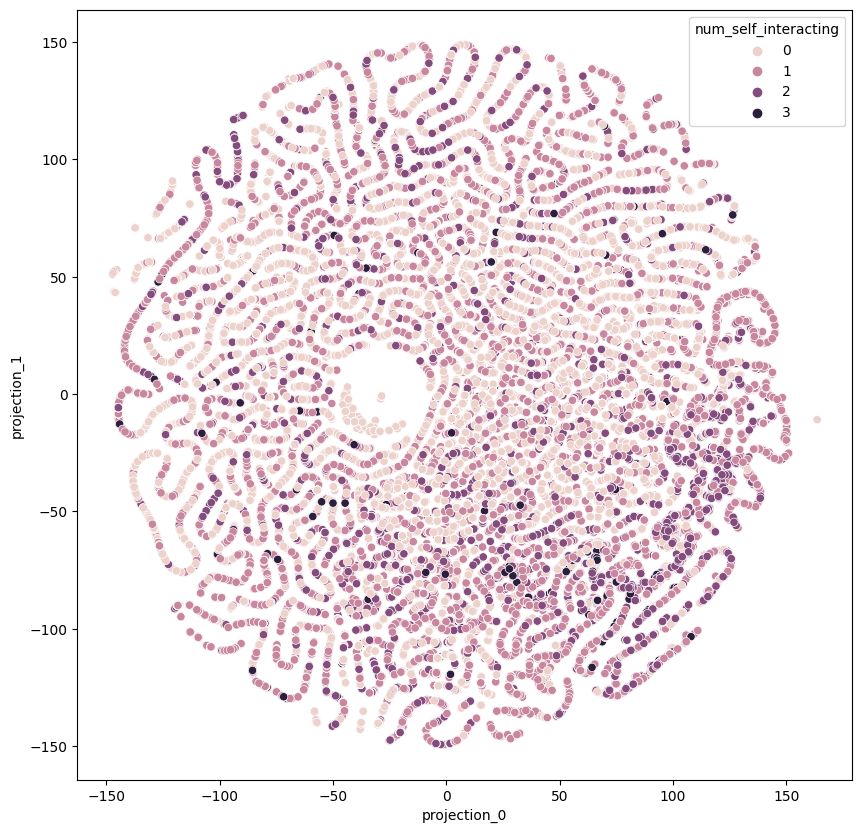

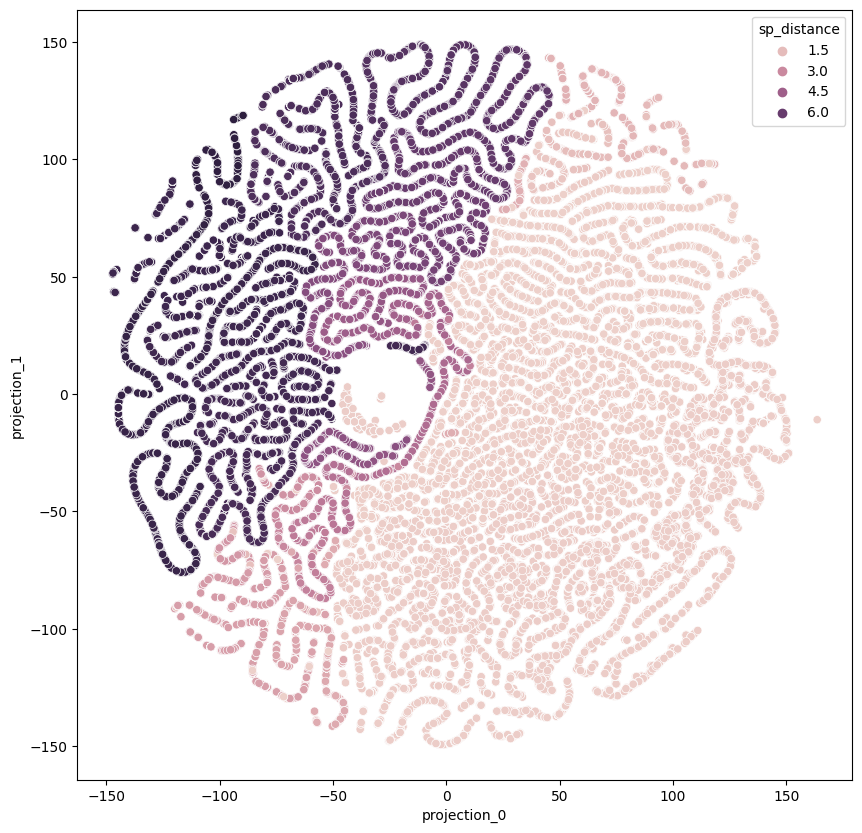

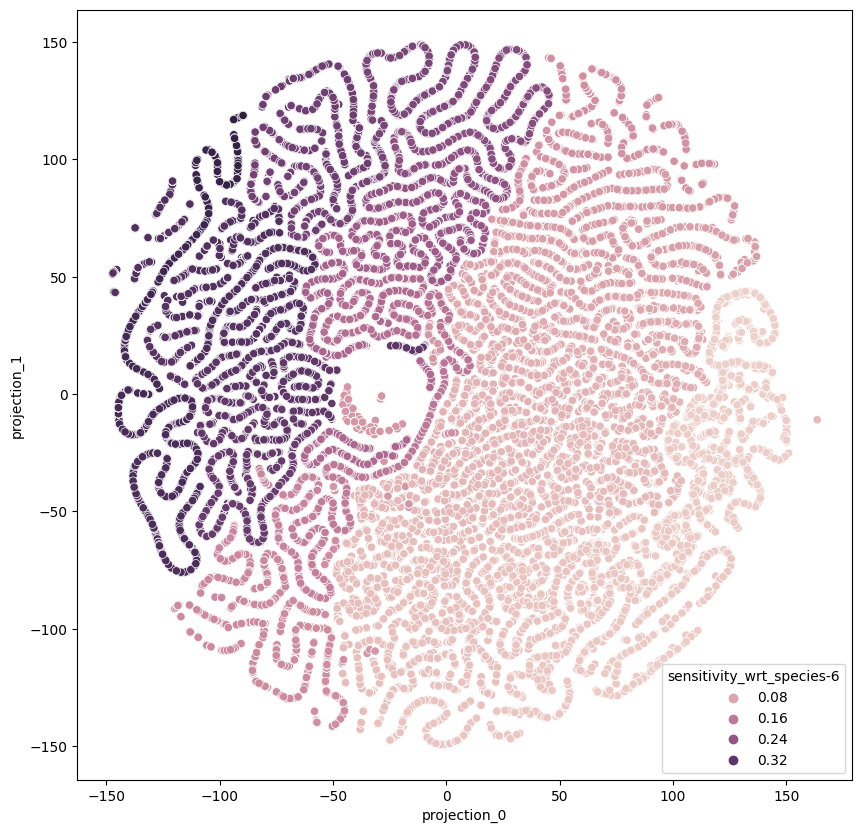

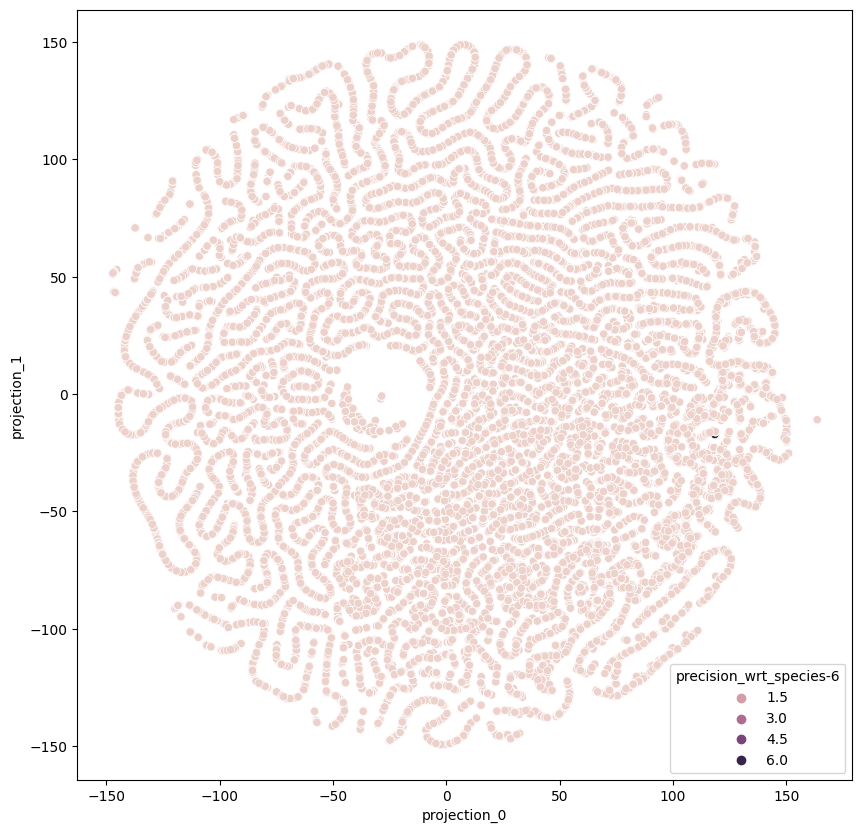

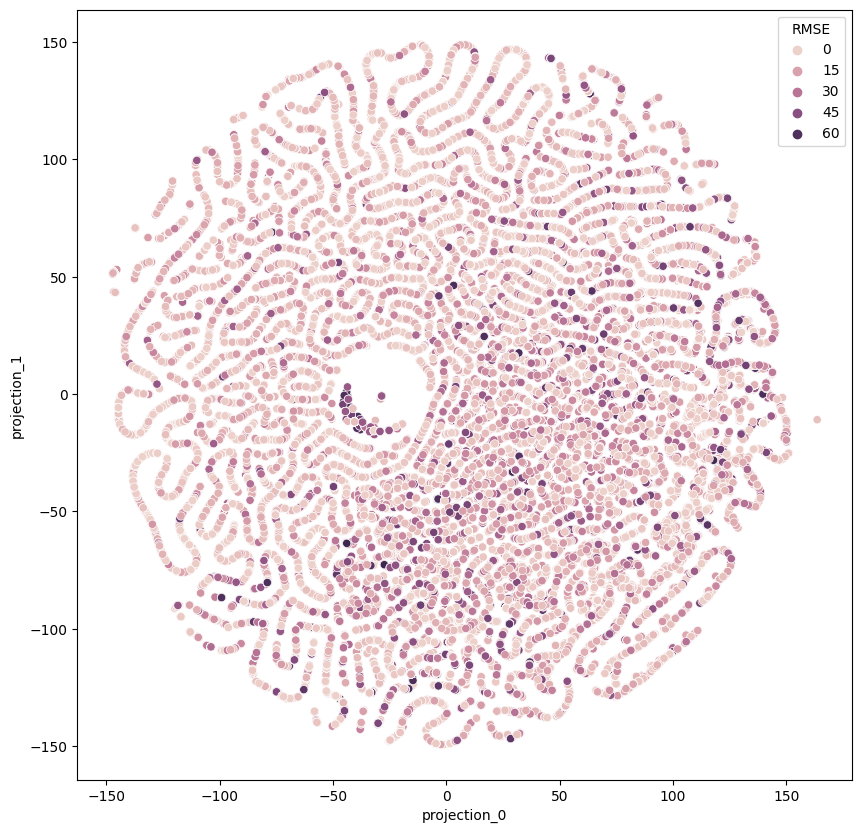

In [ ]:

for h in ['mutation_num', 'num_interacting_all', 'num_interacting', 'num_self_interacting', 'sp_distance', 'sensitivity_wrt_species-6', 'precision_wrt_species-6', 'RMSE']:
    plt.figure(figsize=(10, 10))
    sns.scatterplot(
        data, x='projection_0', y='projection_1',
        hue=h
    )

In [ ]:

fig = px.scatter(
    data, x='projection_0', y='projection_1',
    color='num_interacting_all', labels={'color': 'num_interacting_all'},
    hover_name="circuit_name"
)
fig.show()

### Multi-value per circuit

In [42]:
projections_g = np.array([])
for seed in np.arange(10):
    tsne = TSNE(n_components=2, random_state=seed)
    p = tsne.fit_transform(grp_mutations)
    if len(projections_g):
        projections_g = np.concatenate([projections_g, p])
    else:
        projections_g = p

In [43]:
projections_g_mean = projections_g.reshape((10, grp_mutations.shape[0], 2)).mean(axis=0)

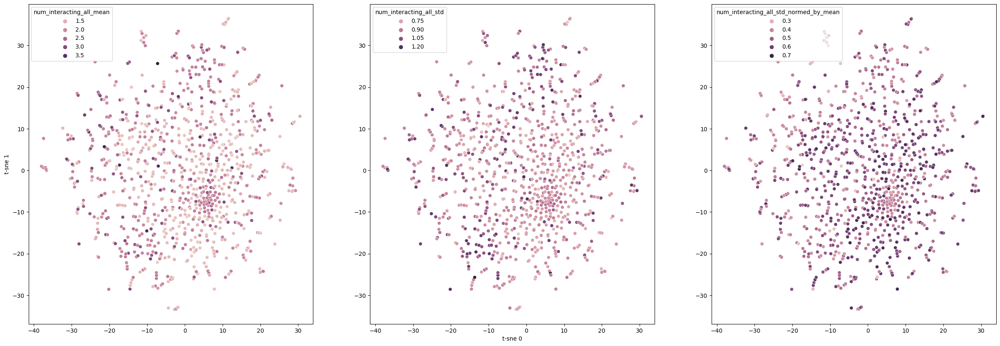

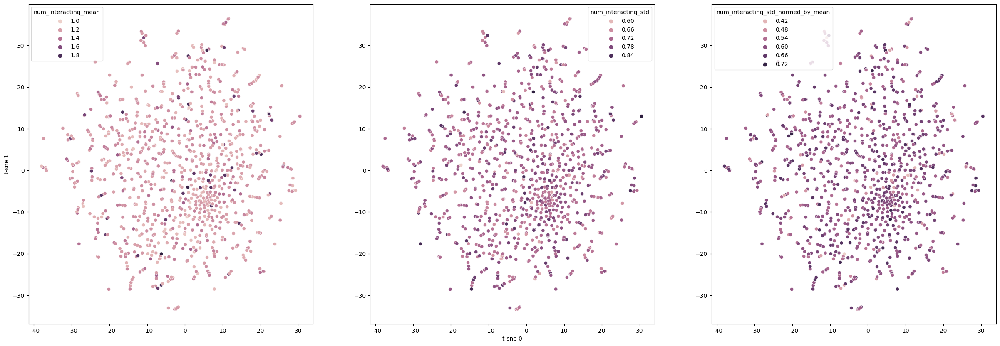

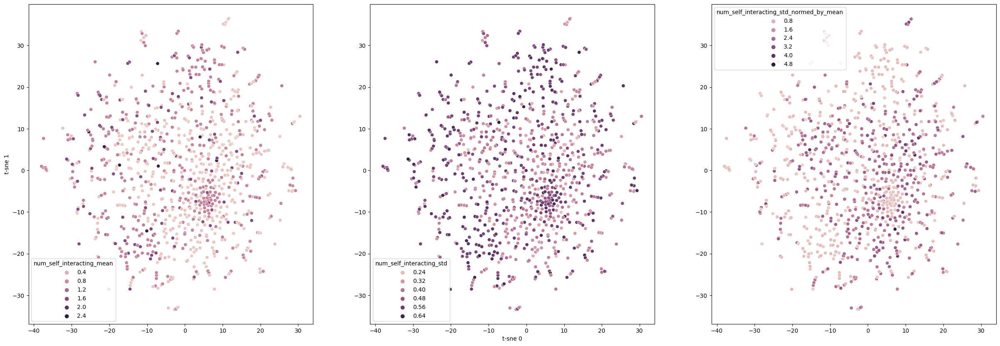

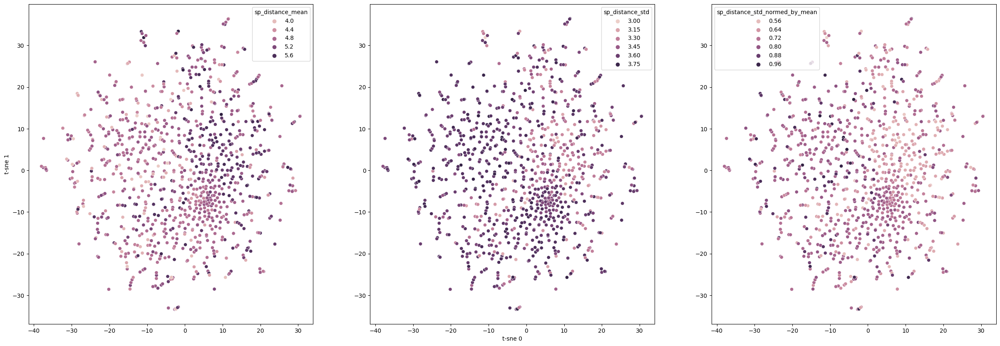

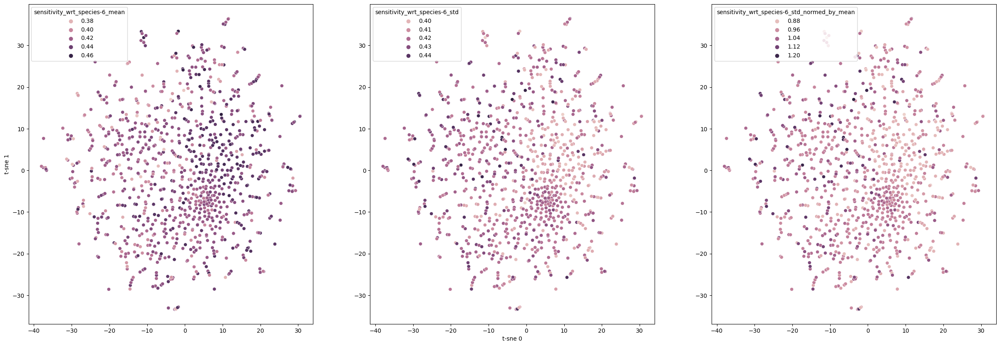

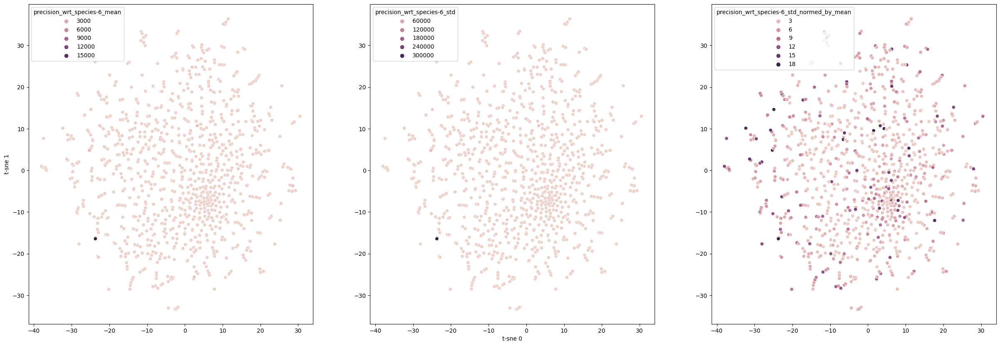

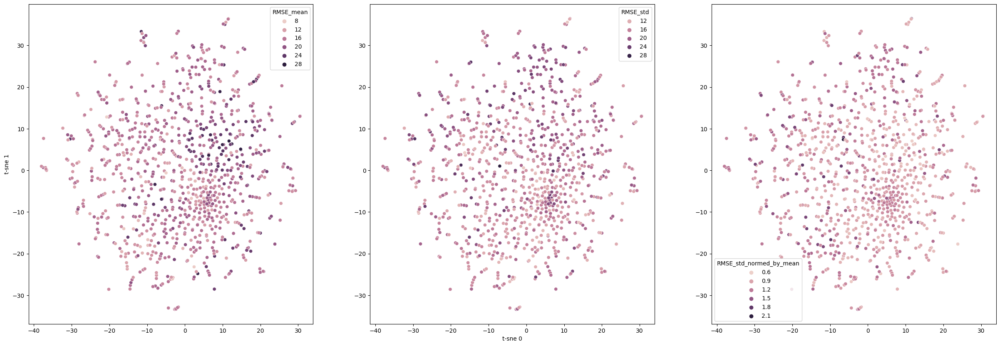

In [44]:
# data['projections_g0'] = projections_g_mean[:, 0]
# data['projections_g1'] = projections_g_mean[:, 1]
for h in ['num_interacting_all', 'num_interacting', 'num_self_interacting', 'sp_distance', 'sensitivity_wrt_species-6', 'precision_wrt_species-6', 'RMSE']:
    plt.figure(figsize=(30, 10))
    ax = plt.subplot(1,3,1)
    sns.scatterplot(
        x=projections_g_mean[:, 0], y=projections_g_mean[:, 1],
        # hue=info.pivot_table(h, 'circuit_name').to_numpy().squeeze()
        hue=info.groupby(['circuit_name']).agg({h: 'mean'}).to_numpy().squeeze()
    )
    plt.ylabel('t-sne 1')
    plt.legend(title=h + '_mean')
    ax = plt.subplot(1,3,2)
    sns.scatterplot(
        x=projections_g_mean[:, 0], y=projections_g_mean[:, 1],
        hue=info.groupby(['circuit_name']).agg({h: 'std'}).to_numpy().squeeze()
    )
    plt.xlabel('t-sne 0')
    plt.legend(title=h + '_std')
    ax = plt.subplot(1,3,3)
    sns.scatterplot(
        x=projections_g_mean[:, 0], y=projections_g_mean[:, 1],
        hue=info.groupby(['circuit_name']).agg({h: lambda x: np.std(x) / np.where(np.mean(x) != 0, np.mean(x), 1)}).to_numpy().squeeze()
    )
    plt.legend(title=h + '_std_normed_by_mean')

## Potential correlations

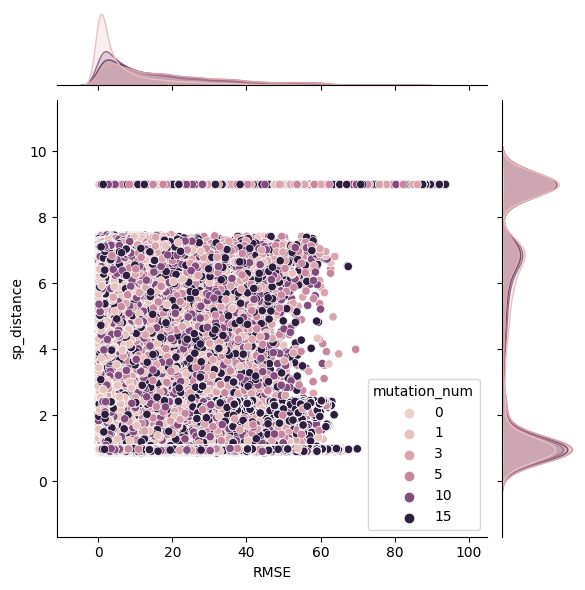

In [ ]:
sns.jointplot(info, x='RMSE', y='sp_distance', hue='mutation_num')